In [1]:
# Importing the necessary packages
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
import matplotlib.animation as animation
from IPython.display import HTML
# This code makes charts appear in the notebook in the first run
%matplotlib inline

In [2]:
# Import and show dataframe created during the lecture
# You can download it from moodle or use the dropbox link
df = pd.read_csv('https://www.dropbox.com/scl/fi/b4vyh559u88j8jlzkhwz1/city_populations_updated.csv?rlkey=ak3juioaq506kyt3d3qh7cr1s&raw=1')
df

,City,Continent,Year,Population
0,Agra,Asia,1575,200.0
1,Agra,Asia,1576,212.0
2,Agra,Asia,1577,224.0
3,Agra,Asia,1578,236.0
4,Agra,Asia,1579,248.0
...,...,...,...,...
6247,Vijayanagar,Asia,1561,480.0
6248,Vijayanagar,Asia,1562,480.0
6249,Vijayanagar,Asia,1563,480.0
6250,Vijayanagar,Asia,1564,480.0


In [3]:
## Create colours dictionary
colours = dict(zip(
    ['Europe', 'Asia', 'South America', 'North America', 'Africa'],
    ['#adb0ff', '#90d595','#aafbff', '#f7bb5f', '#eafb50']))
group_lk = df.set_index('City')['Continent'].to_dict()

In [4]:
# I updated the draw_barcart function to take on a global parameter for the range of years
# In addition, there is another global parameter that defines the number of barcharts
# By changing the number inside .tail() method in line 7, you change the number of charts shown
# You can only show 12 cities per year since there are only 12 entries per year in the dataset!
rangeofyears = False
numberofbars = 5
def draw_barchart(year):
    global rangeofyears
    global numberofbars
    dff = df[df['Year'].eq(year)].sort_values(by='Population', ascending=True).tail(numberofbars)
    ax.clear()
    ax.barh(dff['City'], dff['Population'], color=[colours[group_lk[x]] for x in dff['City']])
    dx = dff['Population'].max() / 200
    for i, (value, name) in enumerate(zip(dff['Population'], dff['City'])):
        ax.text(value-dx, i,     name,           size=14, weight=600, ha='right', va='bottom')
        ax.text(value-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i,     f'{value:,.0f}',  size=14, ha='left',  va='center')
    # ... polished styles
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(0, 1.06, 'Population (thousands)', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    if rangeofyears:
        ax.text(0, 1.12, 'The most populous cities in the world '+rangeofyears,
            transform=ax.transAxes, size=24, weight=600, ha='left')
    else:
        ax.text(0, 1.12, 'The most populous cities in the world '+str(year),
                transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)

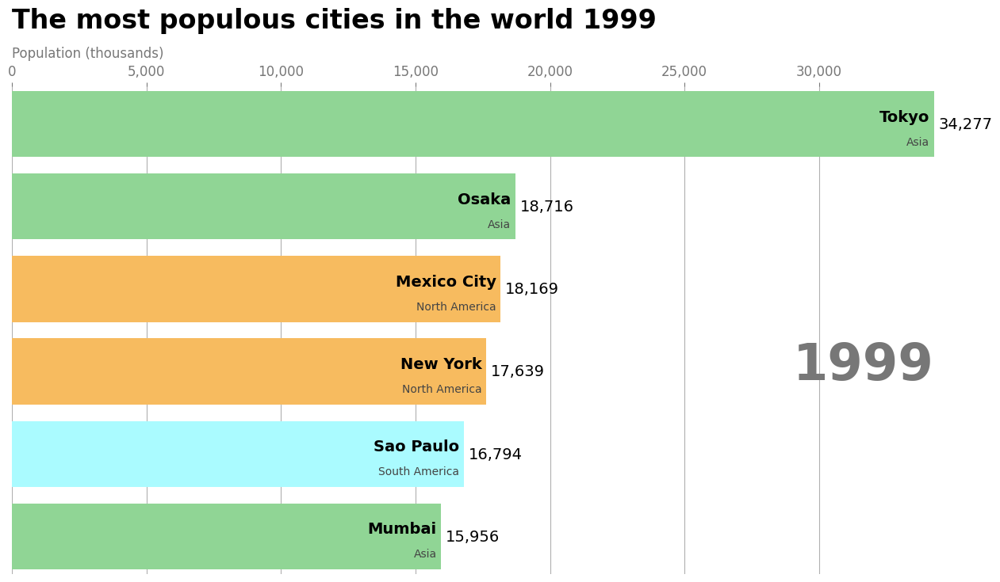

In [5]:
# With this function we draw the bar chart for a given year
# Since there is no "rangeofyears" yet, it will show only the current year in the title
# Moreover, you can change the number of bars to draw
rangeofyears = False
numberofbars = 6
fig, ax = plt.subplots(figsize=(15, 8))
draw_barchart(1999)

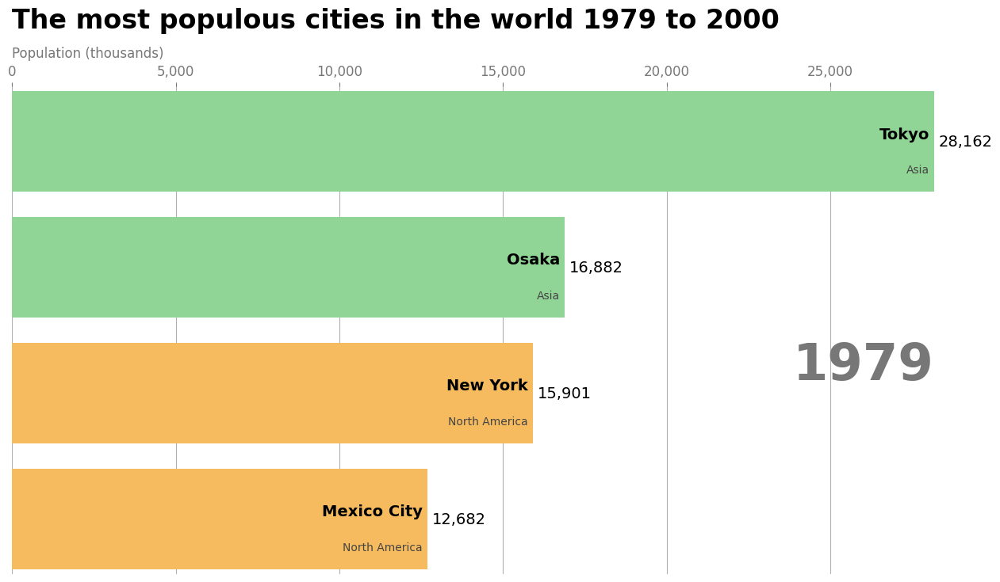

In [6]:
# Now, you can define the first and last year to create the rangeofyears parameter
firstyear = 1979
lastyear = 2000
rangeofyears = str(firstyear)+' to '+str(lastyear)
numberofbars = 4

fig, ax = plt.subplots(figsize=(15, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(firstyear,lastyear))
HTML(animator.to_jshtml())

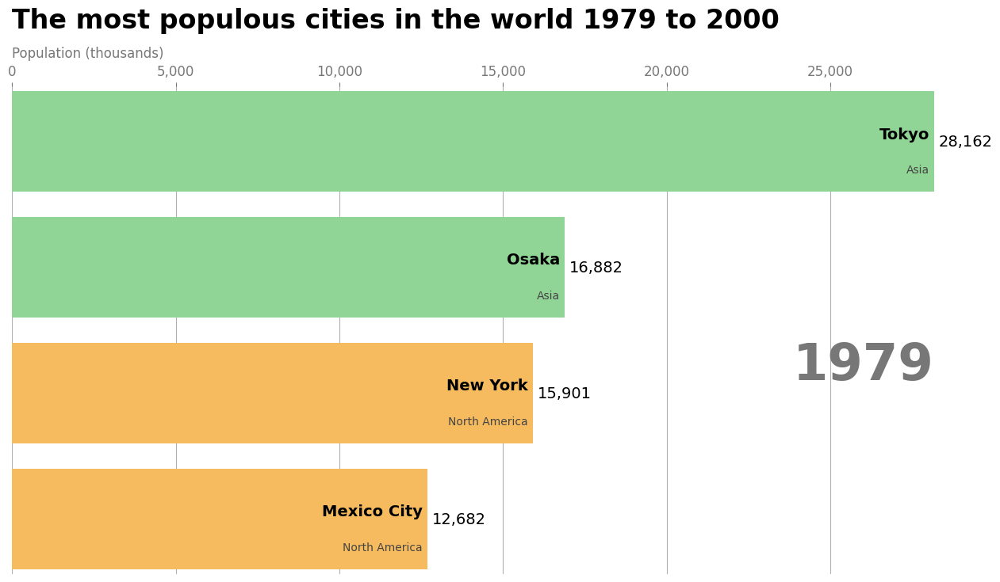

In [7]:
# You can even put an extra parameter called "step" to skip years
firstyear = 1979
lastyear = 2000
step = 2
rangeofyears = str(firstyear)+' to '+str(lastyear)
numberofbars = 4

fig, ax = plt.subplots(figsize=(15, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(firstyear,lastyear,step))
HTML(animator.to_jshtml())

To get rid of the second plot, we can use the 'html5_video' rendering option. Moreover, you can right click this video and save it!

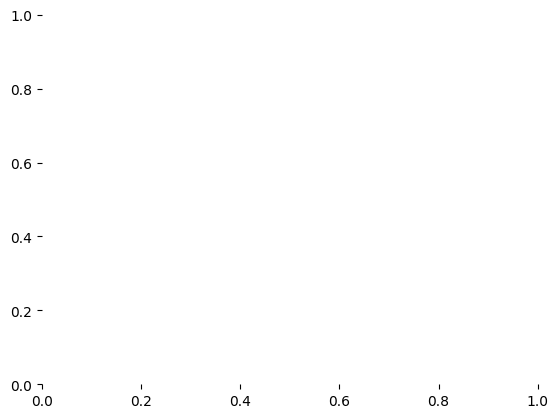

In [8]:
from IPython import display
video = animator.to_html5_video()
html = display.HTML(video)
display.display(html)

If you increase the size of the buffer, you can get the animation to run from 1500 to 2010 (takes some time, but it works!)

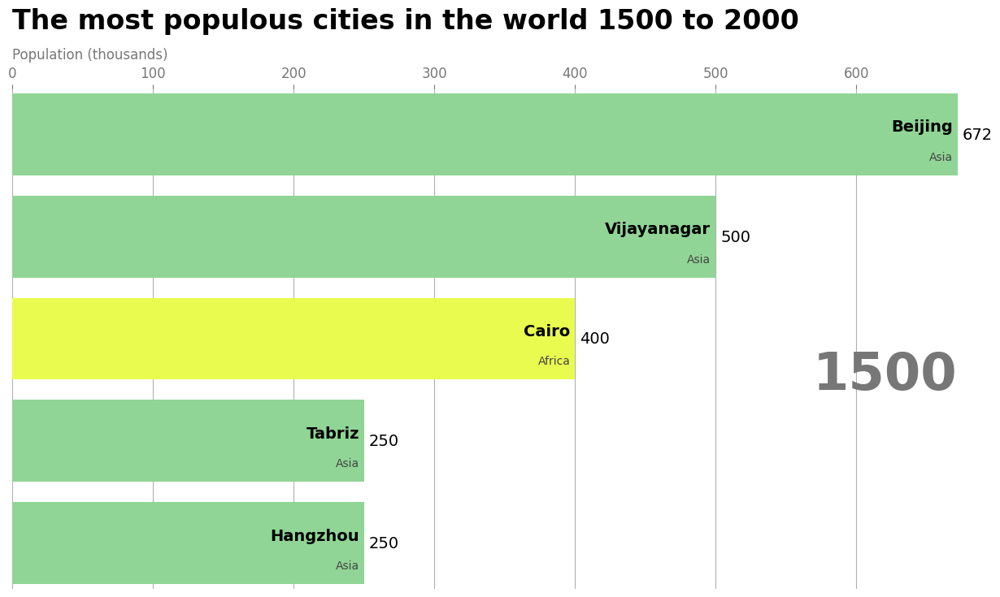

In [9]:
# if you get the error message below
# "Animation size has reached 20997590 bytes, exceeding the limit of 20971520.0
# Set the animation.embed_limit rc parameter to a larger value (in MB)
# This and further frames will be dropped
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

firstyear = 1500
lastyear = 2000
step = 1
numberofbars = 5

rangeofyears = str(firstyear)+' to '+str(lastyear)
fig, ax = plt.subplots(figsize=(15, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(firstyear,lastyear,step))
HTML(animator.to_jshtml())